[['Refrigerator A' 0.751 999.9 3]
 ['Cell phone' 8.99e-06 2199.12 2]
 ['TV 55' 0.4 4346.99 5]
 ['TV 50' 0.29 3999.9 5]
 ['TV 42' 0.2 2999.0 5]
 ['Notebook A' 0.0035 2499.9 4]
 ['Ventilator' 0.496 199.9 12]
 ['Microwave A' 0.0424 308.66 7]
 ['Microwave B' 0.0544 429.9 7]
 ['Microwave C' 0.0319 299.29 9]
 ['Refrigerator B' 0.635 849.0 4]
 ['Refrigerator C' 0.87 1199.89 2]
 ['Notebook B' 0.498 1999.0 6]
 ['Notebook C' 0.527 3999.0 6]]
77
Generation 1: Best Fitness = -33956.56
Generation 2: Best Fitness = -32474.84
Generation 3: Best Fitness = -22616.34
Generation 4: Best Fitness = -21777.57
Generation 5: Best Fitness = -16910.96
Generation 6: Best Fitness = 16668.329999999998


/home/ste/Desktop/bus_project/Genetic-Algorithms/.venv/lib/python3.10/site-packages/pygad/pygad.py:909: UserWarning: The steady-state parent (sss) selection operator is used despite that no parents are kept in the next generation.
  warnings.warn("The steady-state parent (sss) selection operator is used despite that no parents are kept in the next generation.")
/home/ste/Desktop/bus_project/Genetic-Algorithms/.venv/lib/python3.10/site-packages/pygad/pygad.py:1139: UserWarning: The 'delay_after_gen' parameter is deprecated starting from PyGAD 3.3.0. To delay or pause the evolution after each generation, assign a callback function/method to the 'on_generation' parameter to adds some time delay.
  warnings.warn("The 'delay_after_gen' parameter is deprecated starting from PyGAD 3.3.0. To delay or pause the evolution after each generation, assign a callback function/method to the 'on_generation' parameter to adds some time delay.")


Generation 7: Best Fitness = 19588.76
Generation 8: Best Fitness = 25138.13
Generation 9: Best Fitness = 34593.0
Generation 10: Best Fitness = 36184.08
Generation 11: Best Fitness = 43303.19
Generation 12: Best Fitness = 48289.35
Generation 13: Best Fitness = 50150.86
Generation 14: Best Fitness = 54972.51
Generation 15: Best Fitness = 59102.03
Generation 16: Best Fitness = 59102.03
Generation 17: Best Fitness = 63297.909999999996
Generation 18: Best Fitness = 63297.909999999996
Generation 19: Best Fitness = 64576.03
Generation 20: Best Fitness = 64576.03
Generation 21: Best Fitness = 64576.03
Generation 22: Best Fitness = 64576.03
Generation 23: Best Fitness = 64721.92
Generation 24: Best Fitness = 64721.92
Generation 25: Best Fitness = 66874.63
Generation 26: Best Fitness = 66874.63
Generation 27: Best Fitness = 67473.20999999999
Generation 28: Best Fitness = 67473.20999999999
Generation 29: Best Fitness = 67473.20999999999
Generation 30: Best Fitness = 67473.20999999999
Generation 3

/home/ste/Desktop/bus_project/Genetic-Algorithms/.venv/lib/python3.10/site-packages/pygad/visualize/plot.py:109: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  matplotlib.pyplot.legend()


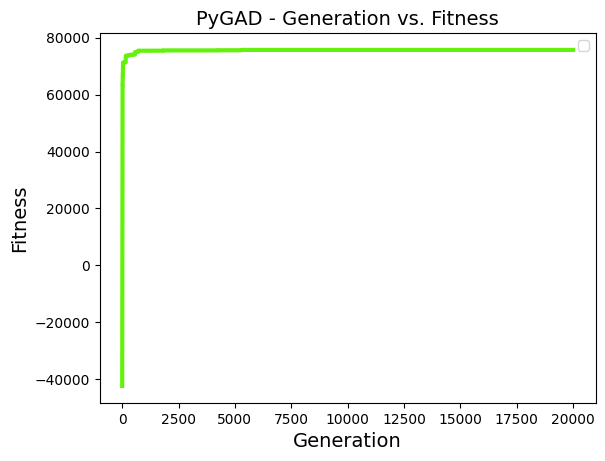

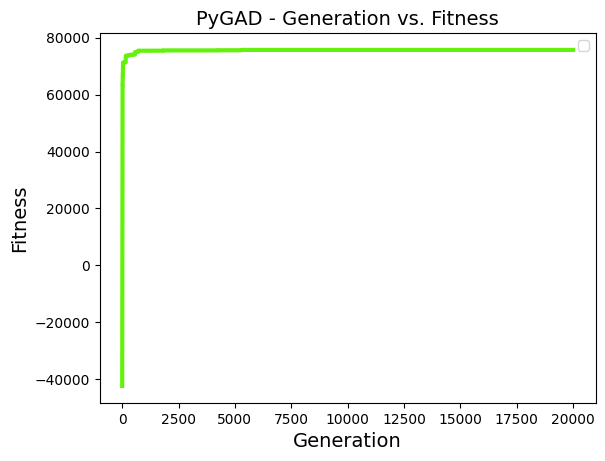

In [40]:
import pygad
import numpy as np
import pandas as pd
# Sample data (Replace this with the actual data from the file)
# Format: [occupied space, price, quantity]
data = pd.read_excel("products.xlsx").values
print(data)

'''
[['Refrigerator A' 0.751 999.9 3]
 ['Cell phone' 8.99e-06 2199.12 2]
 ['TV 55' 0.4 4346.99 5]
 ['TV 50' 0.29 3999.9 5]
 ['TV 42' 0.2 2999.0 5]
 ['Notebook A' 0.0035 2499.9 4]
 ['Ventilator' 0.496 199.9 12]
 ['Microwave A' 0.0424 308.66 7]
 ['Microwave B' 0.0544 429.9 7]
 ['Microwave C' 0.0319 299.29 9]
 ['Refrigerator B' 0.635 849.0 4]
 ['Refrigerator C' 0.87 1199.89 2]
 ['Notebook B' 0.498 1999.0 6]
 ['Notebook C' 0.527 3999.0 6]]
'''
occupied_space= []
prices = []
names = []
for i in range(len(data)):
    for j in range(data[i][3]):
        #newData.npVstack[data[i][0], data[i][1], data[i][2]]
        occupied_space.append(data[i][1])
        prices.append(data[i][2])
        names.append(data[i][0])

# Extract the relevant columns: space, price, and quantity

# Volume capacity of the van (you can change this value to test different scenarios)
volume_capacity = 5

# Number of products
num_products = len(occupied_space)
print(num_products)
# Fitness function to maximize the total value without exceeding volume capacity
def fitness_function(ga_instance, solution, solution_idx):
    total_value = np.sum(solution * prices)
    total_space = np.sum(solution * occupied_space)
    if total_space > volume_capacity:
        return -total_value
    
    return total_value

# Genetic algorithm parameters
ga_instance = pygad.GA(
    num_generations=20000,  # Increased number of generations
    num_parents_mating=20,  # More parents mating
    fitness_func=fitness_function,
    sol_per_pop=100,  # Increased population size
    num_genes=num_products,
    init_range_low=0,
    init_range_high=2,  # Wider range for initial genes
    mutation_percent_genes=5,  # Lower mutation rate to reduce disruption
    crossover_type="two_points",  # Different crossover type
    mutation_type="random",  # Different mutation type
    mutation_by_replacement=True,  # Less disruptive mutation
    gene_space=[0, 1],
    keep_parents=0,  # Keep the top 2 parents
    on_generation=lambda instance: print(f"Generation {instance.generations_completed}: Best Fitness = {instance.best_solution()[1]}")
)


# Run the GA
ga_instance.run()

# Retrieve the best solution
solution, solution_fitness, _ = ga_instance.best_solution()
print(f"Best solution: {solution}")
print(f"Best solution fitness (total value): {solution_fitness}")
print(f"Total occupied space: {np.sum(solution * occupied_space)}")
print(f"Total price: {np.sum(solution * prices)}")

# Plot the fitness over generations (Optional)
ga_instance.plot_fitness()


In [14]:
solution

array([0., 0., 1., 0., 1., 0., 1., 0., 0., 0., 0., 0., 0., 1., 1., 1., 0.,
       1., 0., 0., 0., 0., 0., 1., 0., 1., 0., 0., 0., 0., 0., 1., 1., 1.,
       0., 0., 1., 1., 1., 0., 0., 1., 0., 1., 0., 0., 1., 0., 1., 0., 1.,
       0., 1., 1., 0., 0., 0., 0., 0., 1., 1., 1., 0., 1., 0., 0., 1., 0.,
       1., 0., 1., 1., 0., 0., 0., 1., 0.])

In [15]:
names

['Refrigerator A',
 'Refrigerator A',
 'Refrigerator A',
 'Cell phone',
 'Cell phone',
 'TV 55',
 'TV 55',
 'TV 55',
 'TV 55',
 'TV 55',
 'TV 50',
 'TV 50',
 'TV 50',
 'TV 50',
 'TV 50',
 'TV 42',
 'TV 42',
 'TV 42',
 'TV 42',
 'TV 42',
 'Notebook A',
 'Notebook A',
 'Notebook A',
 'Notebook A',
 'Ventilator',
 'Ventilator',
 'Ventilator',
 'Ventilator',
 'Ventilator',
 'Ventilator',
 'Ventilator',
 'Ventilator',
 'Ventilator',
 'Ventilator',
 'Ventilator',
 'Ventilator',
 'Microwave A',
 'Microwave A',
 'Microwave A',
 'Microwave A',
 'Microwave A',
 'Microwave A',
 'Microwave A',
 'Microwave B',
 'Microwave B',
 'Microwave B',
 'Microwave B',
 'Microwave B',
 'Microwave B',
 'Microwave B',
 'Microwave C',
 'Microwave C',
 'Microwave C',
 'Microwave C',
 'Microwave C',
 'Microwave C',
 'Microwave C',
 'Microwave C',
 'Microwave C',
 'Refrigerator B',
 'Refrigerator B',
 'Refrigerator B',
 'Refrigerator B',
 'Refrigerator C',
 'Refrigerator C',
 'Notebook B',
 'Notebook B',
 'Notebook 

In [42]:
import pygad
import numpy as np
import optuna

# Define the Optuna objective function
def objective(trial):
    # Suggest hyperparameters to be optimized
    num_generations = trial.suggest_int('num_generations', 5000, 20000)
    sol_per_pop = trial.suggest_int('sol_per_pop', 20, 100)
    num_parents_mating = trial.suggest_int('num_parents_mating', 5, 20)
    mutation_percent_genes = trial.suggest_float('mutation_percent_genes', 5, 20)
    crossover_type = trial.suggest_categorical('crossover_type', ['single_point', 'two_points', 'uniform'])
    mutation_type = trial.suggest_categorical('mutation_type', ['random', 'swap'])


    def fitness_function(ga_instance, solution, solution_idx):
        total_value = np.sum(solution * prices)
        total_space = np.sum(solution * occupied_space)
        if total_space > volume_capacity:
            return -total_value
        
        return total_value

    # Genetic algorithm parameters
    ga_instance = pygad.GA(
        num_generations=num_generations,  # Increased number of generations
        num_parents_mating=num_parents_mating,  # More parents mating
        fitness_func=fitness_function,
        sol_per_pop=sol_per_pop,  # Increased population size
        num_genes=num_products,
        init_range_low=0,
        init_range_high=2,  # Wider range for initial genes
        mutation_percent_genes=mutation_percent_genes,  # Lower mutation rate to reduce disruption
        crossover_type=crossover_type,  # Different crossover type
        mutation_type=mutation_type,  # Different mutation type
        mutation_by_replacement=True,  # Less disruptive mutation
        gene_space=[0, 1],
        keep_parents=0,  # Keep the top 2 parents
        on_generation=lambda instance: print(f"Generation {instance.generations_completed}: Best Fitness = {instance.best_solution()[1]}")
    )
    # Run the GA
    ga_instance.run()

    # Get the best solution fitness
    solution, solution_fitness, _ = ga_instance.best_solution()
    
    return solution_fitness  # Optuna maximizes this

# Run the optimization
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=50)  # You can adjust the number of trials

# Get the best hyperparameters
print("Best hyperparameters: ", study.best_params)
print("Best fitness: ", study.best_value)


[I 2024-08-25 14:23:03,406] A new study created in memory with name: no-name-c4c4aa62-67da-4fc1-8da8-c88018a39e77


/home/ste/Desktop/bus_project/Genetic-Algorithms/.venv/lib/python3.10/site-packages/pygad/pygad.py:832: UserWarning: The mutation_by_replacement parameter is set to True while the mutation_type parameter is not set to random but (swap). Note that the mutation_by_replacement parameter has an effect only when mutation_type='random'.
  warnings.warn(f"The mutation_by_replacement parameter is set to True while the mutation_type parameter is not set to random but ({mutation_type}). Note that the mutation_by_replacement parameter has an effect only when mutation_type='random'.")
/home/ste/Desktop/bus_project/Genetic-Algorithms/.venv/lib/python3.10/site-packages/pygad/pygad.py:909: UserWarning: The steady-state parent (sss) selection operator is used despite that no parents are kept in the next generation.
  warnings.warn("The steady-state parent (sss) selection operator is used despite that no parents are kept in the next generation.")


Generation 1: Best Fitness = -31147.289999999994
Generation 2: Best Fitness = -29240.17
Generation 3: Best Fitness = -19287.71
Generation 4: Best Fitness = -15438.36
Generation 5: Best Fitness = 16000.539999999997
Generation 6: Best Fitness = 18361.949999999997
Generation 7: Best Fitness = 23935.59
Generation 8: Best Fitness = 26826.349999999995
Generation 9: Best Fitness = 38821.71
Generation 10: Best Fitness = 38821.71
Generation 11: Best Fitness = 38821.71
Generation 12: Best Fitness = 42990.08
Generation 13: Best Fitness = 45502.369999999995
Generation 14: Best Fitness = 45801.659999999996
Generation 15: Best Fitness = 49050.52
Generation 16: Best Fitness = 49827.509999999995
Generation 17: Best Fitness = 49910.32
Generation 18: Best Fitness = 50566.06999999999
Generation 19: Best Fitness = 50566.06999999999
Generation 20: Best Fitness = 50566.06999999999
Generation 21: Best Fitness = 50566.06999999999
Generation 22: Best Fitness = 50566.06999999999
Generation 23: Best Fitness = 50

[I 2024-08-25 14:26:35,058] Trial 0 finished with value: 50566.06999999999 and parameters: {'num_generations': 8436, 'sol_per_pop': 54, 'num_parents_mating': 14, 'mutation_percent_genes': 11.70308051344158, 'crossover_type': 'uniform', 'mutation_type': 'swap'}. Best is trial 0 with value: 50566.06999999999.


Generation 8436: Best Fitness = 50566.06999999999
Generation 1: Best Fitness = -33191.96
Generation 2: Best Fitness = -23474.43
Generation 3: Best Fitness = -19675.33
Generation 4: Best Fitness = -18157.9
Generation 5: Best Fitness = -14660.730000000001
Generation 6: Best Fitness = -12060.420000000002
Generation 7: Best Fitness = -11110.91
Generation 8: Best Fitness = -10419.67
Generation 9: Best Fitness = -10019.150000000001
Generation 10: Best Fitness = -8112.01
Generation 11: Best Fitness = -7912.109999999999
Generation 12: Best Fitness = -7790.87
Generation 13: Best Fitness = -7590.97
Generation 14: Best Fitness = -7590.97
Generation 15: Best Fitness = -7590.97
Generation 16: Best Fitness = 9241.87
Generation 17: Best Fitness = 11941.58
Generation 18: Best Fitness = 15740.68
Generation 19: Best Fitness = 17539.78
Generation 20: Best Fitness = 19441.29
Generation 21: Best Fitness = 21240.39
Generation 22: Best Fitness = 22038.59
Generation 23: Best Fitness = 23039.49
Generation 24: 

[I 2024-08-25 14:36:51,424] Trial 1 finished with value: 23039.49 and parameters: {'num_generations': 13276, 'sol_per_pop': 85, 'num_parents_mating': 15, 'mutation_percent_genes': 13.338155676490432, 'crossover_type': 'single_point', 'mutation_type': 'swap'}. Best is trial 0 with value: 50566.06999999999.


Generation 13272: Best Fitness = 23039.49
Generation 13273: Best Fitness = 23039.49
Generation 13274: Best Fitness = 23039.49
Generation 13275: Best Fitness = 23039.49
Generation 13276: Best Fitness = 23039.49
Generation 1: Best Fitness = -33435.53
Generation 2: Best Fitness = -28838.73
Generation 3: Best Fitness = -28838.73
Generation 4: Best Fitness = -25895.07
Generation 5: Best Fitness = -19482.82
Generation 6: Best Fitness = 31418.35
Generation 7: Best Fitness = 31418.35
Generation 8: Best Fitness = 31418.35
Generation 9: Best Fitness = 35766.33
Generation 10: Best Fitness = 35766.33
Generation 11: Best Fitness = 35766.33
Generation 12: Best Fitness = 39510.89
Generation 13: Best Fitness = 41795.990000000005
Generation 14: Best Fitness = 43949.159999999996
Generation 15: Best Fitness = 43949.159999999996
Generation 16: Best Fitness = 46130.41
Generation 17: Best Fitness = 49568.94
Generation 18: Best Fitness = 49568.94
Generation 19: Best Fitness = 49568.94
Generation 20: Best Fit

[I 2024-08-25 14:39:52,351] Trial 2 finished with value: 75456.73999999999 and parameters: {'num_generations': 18485, 'sol_per_pop': 28, 'num_parents_mating': 12, 'mutation_percent_genes': 5.9111353204630825, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 2 with value: 75456.73999999999.


Generation 1: Best Fitness = -24284.63
Generation 2: Best Fitness = -24284.63
Generation 3: Best Fitness = -19564.38
Generation 4: Best Fitness = 18148.15
Generation 5: Best Fitness = 26005.219999999998
Generation 6: Best Fitness = 31104.54
Generation 7: Best Fitness = 33234.119999999995
Generation 8: Best Fitness = 44941.990000000005
Generation 9: Best Fitness = 44941.990000000005
Generation 10: Best Fitness = 44941.990000000005
Generation 11: Best Fitness = 44941.990000000005
Generation 12: Best Fitness = 44941.990000000005
Generation 13: Best Fitness = 44941.990000000005
Generation 14: Best Fitness = 44941.990000000005
Generation 15: Best Fitness = 44941.990000000005
Generation 16: Best Fitness = 44941.990000000005
Generation 17: Best Fitness = 44941.990000000005
Generation 18: Best Fitness = 44941.990000000005
Generation 19: Best Fitness = 44941.990000000005
Generation 20: Best Fitness = 44941.990000000005
Generation 21: Best Fitness = 49472.95
Generation 22: Best Fitness = 49472.9

[I 2024-08-25 14:42:12,444] Trial 3 finished with value: 71277.89 and parameters: {'num_generations': 7498, 'sol_per_pop': 54, 'num_parents_mating': 12, 'mutation_percent_genes': 11.641802543123756, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 2 with value: 75456.73999999999.


Generation 7498: Best Fitness = 71277.89
Generation 1: Best Fitness = -42113.0
Generation 2: Best Fitness = -36269.36
Generation 3: Best Fitness = -30216.469999999998
Generation 4: Best Fitness = -30117.08
Generation 5: Best Fitness = -27865.179999999997
Generation 6: Best Fitness = -23973.91
Generation 7: Best Fitness = -21918.38
Generation 8: Best Fitness = -15428.04
Generation 9: Best Fitness = 11800.39
Generation 10: Best Fitness = 11800.39
Generation 11: Best Fitness = 16679.14
Generation 12: Best Fitness = 16679.14
Generation 13: Best Fitness = 18000.9
Generation 14: Best Fitness = 18000.9
Generation 15: Best Fitness = 21669.39
Generation 16: Best Fitness = 22078.78
Generation 17: Best Fitness = 24406.94
Generation 18: Best Fitness = 27668.51
Generation 19: Best Fitness = 27668.51
Generation 20: Best Fitness = 32578.53
Generation 21: Best Fitness = 34648.53
Generation 22: Best Fitness = 36623.74
Generation 23: Best Fitness = 37277.55
Generation 24: Best Fitness = 37693.84
Generat

[I 2024-08-25 14:44:28,741] Trial 4 finished with value: 42923.83 and parameters: {'num_generations': 13190, 'sol_per_pop': 47, 'num_parents_mating': 19, 'mutation_percent_genes': 6.243419885376863, 'crossover_type': 'two_points', 'mutation_type': 'swap'}. Best is trial 2 with value: 75456.73999999999.


Generation 13178: Best Fitness = 42923.83
Generation 13179: Best Fitness = 42923.83
Generation 13180: Best Fitness = 42923.83
Generation 13181: Best Fitness = 42923.83
Generation 13182: Best Fitness = 42923.83
Generation 13183: Best Fitness = 42923.83
Generation 13184: Best Fitness = 42923.83
Generation 13185: Best Fitness = 42923.83
Generation 13186: Best Fitness = 42923.83
Generation 13187: Best Fitness = 42923.83
Generation 13188: Best Fitness = 42923.83
Generation 13189: Best Fitness = 42923.83
Generation 13190: Best Fitness = 42923.83
Generation 1: Best Fitness = -32745.909999999996
Generation 2: Best Fitness = -28349.410000000003
Generation 3: Best Fitness = -28349.410000000003
Generation 4: Best Fitness = -23805.449999999997
Generation 5: Best Fitness = -23805.449999999997
Generation 6: Best Fitness = -23805.449999999997
Generation 7: Best Fitness = -20156.969999999998
Generation 8: Best Fitness = -20156.969999999998
Generation 9: Best Fitness = -20156.969999999998
Generation 10

[I 2024-08-25 14:56:30,917] Trial 5 finished with value: 61052.67 and parameters: {'num_generations': 14983, 'sol_per_pop': 100, 'num_parents_mating': 16, 'mutation_percent_genes': 19.229547340381288, 'crossover_type': 'uniform', 'mutation_type': 'random'}. Best is trial 2 with value: 75456.73999999999.


Generation 14983: Best Fitness = 61052.67
Generation 1: Best Fitness = -31659.559999999998
Generation 2: Best Fitness = -24595.07
Generation 3: Best Fitness = -22114.45
Generation 4: Best Fitness = -16127.25
Generation 5: Best Fitness = -10439.970000000001
Generation 6: Best Fitness = -8749.630000000001
Generation 7: Best Fitness = 9739.51
Generation 8: Best Fitness = 9969.51
Generation 9: Best Fitness = 14861.269999999999
Generation 10: Best Fitness = 16861.27
Generation 11: Best Fitness = 19069.32
Generation 12: Best Fitness = 21498.22
Generation 13: Best Fitness = 25596.61
Generation 14: Best Fitness = 29313.800000000003
Generation 15: Best Fitness = 29444.41
Generation 16: Best Fitness = 31786.760000000002
Generation 17: Best Fitness = 34812.69
Generation 18: Best Fitness = 35644.01
Generation 19: Best Fitness = 40598.95
Generation 20: Best Fitness = 40598.95
Generation 21: Best Fitness = 40598.95
Generation 22: Best Fitness = 40598.95
Generation 23: Best Fitness = 40598.95
Generat

[I 2024-08-25 14:58:30,463] Trial 6 finished with value: 40598.95 and parameters: {'num_generations': 8796, 'sol_per_pop': 48, 'num_parents_mating': 10, 'mutation_percent_genes': 9.15239251225797, 'crossover_type': 'uniform', 'mutation_type': 'swap'}. Best is trial 2 with value: 75456.73999999999.


Generation 8786: Best Fitness = 40598.95
Generation 8787: Best Fitness = 40598.95
Generation 8788: Best Fitness = 40598.95
Generation 8789: Best Fitness = 40598.95
Generation 8790: Best Fitness = 40598.95
Generation 8791: Best Fitness = 40598.95
Generation 8792: Best Fitness = 40598.95
Generation 8793: Best Fitness = 40598.95
Generation 8794: Best Fitness = 40598.95
Generation 8795: Best Fitness = 40598.95
Generation 8796: Best Fitness = 40598.95
Generation 1: Best Fitness = -32735.620000000003
Generation 2: Best Fitness = -23884.690000000002
Generation 3: Best Fitness = -21484.18
Generation 4: Best Fitness = -18024.619999999995
Generation 5: Best Fitness = -15866.97
Generation 6: Best Fitness = -14975.829999999998
Generation 7: Best Fitness = -14667.169999999998
Generation 8: Best Fitness = -14667.169999999998
Generation 9: Best Fitness = -14667.169999999998
Generation 10: Best Fitness = -14667.169999999998
Generation 11: Best Fitness = -14667.169999999998
Generation 12: Best Fitness 

[I 2024-08-25 15:00:39,156] Trial 7 finished with value: -14667.169999999998 and parameters: {'num_generations': 8261, 'sol_per_pop': 83, 'num_parents_mating': 7, 'mutation_percent_genes': 10.272977981071453, 'crossover_type': 'single_point', 'mutation_type': 'swap'}. Best is trial 2 with value: 75456.73999999999.


Generation 8258: Best Fitness = -14667.169999999998
Generation 8259: Best Fitness = -14667.169999999998
Generation 8260: Best Fitness = -14667.169999999998
Generation 8261: Best Fitness = -14667.169999999998
Generation 1: Best Fitness = -27926.269999999997
Generation 2: Best Fitness = -26949.12
Generation 3: Best Fitness = 27706.769999999997
Generation 4: Best Fitness = 27706.769999999997
Generation 5: Best Fitness = 27706.769999999997
Generation 6: Best Fitness = 27706.769999999997
Generation 7: Best Fitness = 30813.83
Generation 8: Best Fitness = 30813.83
Generation 9: Best Fitness = 30813.83
Generation 10: Best Fitness = 42723.39
Generation 11: Best Fitness = 42723.39
Generation 12: Best Fitness = 42723.39
Generation 13: Best Fitness = 42723.39
Generation 14: Best Fitness = 42723.39
Generation 15: Best Fitness = 42723.39
Generation 16: Best Fitness = 42723.39
Generation 17: Best Fitness = 42723.39
Generation 18: Best Fitness = 42723.39
Generation 19: Best Fitness = 42723.39
Generati

[I 2024-08-25 15:10:05,374] Trial 8 finished with value: 68463.05 and parameters: {'num_generations': 19195, 'sol_per_pop': 76, 'num_parents_mating': 11, 'mutation_percent_genes': 18.122404001825387, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 2 with value: 75456.73999999999.


Generation 1: Best Fitness = -34413.9
Generation 2: Best Fitness = -30792.399999999998
Generation 3: Best Fitness = -23991.739999999998
Generation 4: Best Fitness = -22595.940000000002
Generation 5: Best Fitness = -22595.940000000002
Generation 6: Best Fitness = -22595.940000000002
Generation 7: Best Fitness = -22595.940000000002
Generation 8: Best Fitness = -22595.940000000002
Generation 9: Best Fitness = -22206.43
Generation 10: Best Fitness = -22206.43
Generation 11: Best Fitness = -22206.43
Generation 12: Best Fitness = -22206.43
Generation 13: Best Fitness = -22206.43
Generation 14: Best Fitness = -22206.43
Generation 15: Best Fitness = -22206.43
Generation 16: Best Fitness = -22206.43
Generation 17: Best Fitness = -22206.43
Generation 18: Best Fitness = -22206.43
Generation 19: Best Fitness = -21721.81
Generation 20: Best Fitness = -21721.81
Generation 21: Best Fitness = -21721.81
Generation 22: Best Fitness = -21721.81
Generation 23: Best Fitness = -21721.81
Generation 24: Best 

[I 2024-08-25 15:18:47,649] Trial 9 finished with value: 61003.689999999995 and parameters: {'num_generations': 19382, 'sol_per_pop': 63, 'num_parents_mating': 11, 'mutation_percent_genes': 18.965627782091296, 'crossover_type': 'two_points', 'mutation_type': 'random'}. Best is trial 2 with value: 75456.73999999999.


Generation 19377: Best Fitness = 61003.689999999995
Generation 19378: Best Fitness = 61003.689999999995
Generation 19379: Best Fitness = 61003.689999999995
Generation 19380: Best Fitness = 61003.689999999995
Generation 19381: Best Fitness = 61003.689999999995
Generation 19382: Best Fitness = 61003.689999999995
Generation 1: Best Fitness = -26484.39
Generation 2: Best Fitness = -26484.39
Generation 3: Best Fitness = -21938.98
Generation 4: Best Fitness = -19379.47
Generation 5: Best Fitness = 26520.5
Generation 6: Best Fitness = 26520.5
Generation 7: Best Fitness = 28858.230000000003
Generation 8: Best Fitness = 30806.199999999997
Generation 9: Best Fitness = 34905.92
Generation 10: Best Fitness = 37945.39
Generation 11: Best Fitness = 43258.36
Generation 12: Best Fitness = 44590.89
Generation 13: Best Fitness = 44590.89
Generation 14: Best Fitness = 45318.36
Generation 15: Best Fitness = 45318.36
Generation 16: Best Fitness = 45318.36
Generation 17: Best Fitness = 47278.03
Generation 1

[I 2024-08-25 15:20:42,198] Trial 10 finished with value: 75456.74 and parameters: {'num_generations': 16492, 'sol_per_pop': 20, 'num_parents_mating': 6, 'mutation_percent_genes': 5.350504887256565, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 10 with value: 75456.74.


Generation 16490: Best Fitness = 75456.74
Generation 16491: Best Fitness = 75456.74
Generation 16492: Best Fitness = 75456.74
Generation 1: Best Fitness = -35746.43
Generation 2: Best Fitness = -31512.159999999996
Generation 3: Best Fitness = -30015.07
Generation 4: Best Fitness = -23828.199999999997
Generation 5: Best Fitness = -23828.199999999997
Generation 6: Best Fitness = -22678.2
Generation 7: Best Fitness = -20787.69
Generation 8: Best Fitness = -17177.64
Generation 9: Best Fitness = -11430.03
Generation 10: Best Fitness = -7832.4400000000005
Generation 11: Best Fitness = -7832.4400000000005
Generation 12: Best Fitness = -7832.4400000000005
Generation 13: Best Fitness = -7832.4400000000005
Generation 14: Best Fitness = 8732.650000000001
Generation 15: Best Fitness = 8732.650000000001
Generation 16: Best Fitness = 10765.43
Generation 17: Best Fitness = 19572.89
Generation 18: Best Fitness = 24422.600000000002
Generation 19: Best Fitness = 31865.26
Generation 20: Best Fitness = 32

[I 2024-08-25 15:22:49,261] Trial 11 finished with value: 75671.11 and parameters: {'num_generations': 16593, 'sol_per_pop': 24, 'num_parents_mating': 5, 'mutation_percent_genes': 5.426314630624079, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 11 with value: 75671.11.


Generation 16575: Best Fitness = 75671.11
Generation 16576: Best Fitness = 75671.11
Generation 16577: Best Fitness = 75671.11
Generation 16578: Best Fitness = 75671.11
Generation 16579: Best Fitness = 75671.11
Generation 16580: Best Fitness = 75671.11
Generation 16581: Best Fitness = 75671.11
Generation 16582: Best Fitness = 75671.11
Generation 16583: Best Fitness = 75671.11
Generation 16584: Best Fitness = 75671.11
Generation 16585: Best Fitness = 75671.11
Generation 16586: Best Fitness = 75671.11
Generation 16587: Best Fitness = 75671.11
Generation 16588: Best Fitness = 75671.11
Generation 16589: Best Fitness = 75671.11
Generation 16590: Best Fitness = 75671.11
Generation 16591: Best Fitness = 75671.11
Generation 16592: Best Fitness = 75671.11
Generation 16593: Best Fitness = 75671.11
Generation 1: Best Fitness = -37930.85
Generation 2: Best Fitness = -37930.85
Generation 3: Best Fitness = -37834.84
Generation 4: Best Fitness = -35543.52
Generation 5: Best Fitness = -30063.79
Generat

[I 2024-08-25 15:24:54,865] Trial 12 finished with value: 73626.2 and parameters: {'num_generations': 16258, 'sol_per_pop': 20, 'num_parents_mating': 5, 'mutation_percent_genes': 7.970773536054351, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 11 with value: 75671.11.


Generation 16255: Best Fitness = 73626.2
Generation 16256: Best Fitness = 73626.2
Generation 16257: Best Fitness = 73626.2
Generation 16258: Best Fitness = 73626.2
Generation 1: Best Fitness = -35359.35
Generation 2: Best Fitness = -25396.570000000003
Generation 3: Best Fitness = -25396.570000000003
Generation 4: Best Fitness = -21335.7
Generation 5: Best Fitness = -19625.96
Generation 6: Best Fitness = -17608.94
Generation 7: Best Fitness = 17226.27
Generation 8: Best Fitness = 17257.23
Generation 9: Best Fitness = 25063.699999999997
Generation 10: Best Fitness = 25331.21
Generation 11: Best Fitness = 29351.269999999997
Generation 12: Best Fitness = 32852.68
Generation 13: Best Fitness = 39151.67999999999
Generation 14: Best Fitness = 39151.67999999999
Generation 15: Best Fitness = 40388.88
Generation 16: Best Fitness = 43088.8
Generation 17: Best Fitness = 50888.58
Generation 18: Best Fitness = 50888.58
Generation 19: Best Fitness = 52898.38
Generation 20: Best Fitness = 52898.38
Gen

[I 2024-08-25 15:27:42,489] Trial 13 finished with value: 75727.92000000001 and parameters: {'num_generations': 16299, 'sol_per_pop': 33, 'num_parents_mating': 7, 'mutation_percent_genes': 5.070356062705658, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 16299: Best Fitness = 75727.92000000001
Generation 1: Best Fitness = -32791.07
Generation 2: Best Fitness = -31400.7
Generation 3: Best Fitness = -27901.019999999997
Generation 4: Best Fitness = -27901.019999999997
Generation 5: Best Fitness = -23813.35
Generation 6: Best Fitness = -21768.17
Generation 7: Best Fitness = -18498.03
Generation 8: Best Fitness = -13820.699999999999
Generation 9: Best Fitness = 19361.04
Generation 10: Best Fitness = 21336.72
Generation 11: Best Fitness = 27426.14
Generation 12: Best Fitness = 34779.909999999996
Generation 13: Best Fitness = 35143.2
Generation 14: Best Fitness = 39210.270000000004
Generation 15: Best Fitness = 43696.1
Generation 16: Best Fitness = 44219.54
Generation 17: Best Fitness = 44219.54
Generation 18: Best Fitness = 44554.03
Generation 19: Best Fitness = 44554.03
Generation 20: Best Fitness = 53508.36
Generation 21: Best Fitness = 53508.36
Generation 22: Best Fitness = 53508.36
Generation 23: Best Fitness = 53508.36
Genera

[I 2024-08-25 15:28:39,846] Trial 14 finished with value: 74037.36 and parameters: {'num_generations': 5222, 'sol_per_pop': 36, 'num_parents_mating': 8, 'mutation_percent_genes': 7.755698192465916, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 1: Best Fitness = -33453.100000000006
Generation 2: Best Fitness = -33453.100000000006
Generation 3: Best Fitness = -31830.31
Generation 4: Best Fitness = -29025.75
Generation 5: Best Fitness = -20867.809999999998
Generation 6: Best Fitness = -19180.11
Generation 7: Best Fitness = -17936.620000000003
Generation 8: Best Fitness = -16202.29
Generation 9: Best Fitness = -16202.29
Generation 10: Best Fitness = -16202.29
Generation 11: Best Fitness = -16202.29
Generation 12: Best Fitness = -16202.29
Generation 13: Best Fitness = -16202.29
Generation 14: Best Fitness = 23373.399999999998
Generation 15: Best Fitness = 23373.399999999998
Generation 16: Best Fitness = 29491.579999999998
Generation 17: Best Fitness = 34041.66
Generation 18: Best Fitness = 34041.66
Generation 19: Best Fitness = 34041.66
Generation 20: Best Fitness = 34041.66
Generation 21: Best Fitness = 34041.66
Generation 22: Best Fitness = 34041.66
Generation 23: Best Fitness = 34041.66
Generation 24: Best Fitness =

[I 2024-08-25 15:31:32,717] Trial 15 finished with value: 68145.44 and parameters: {'num_generations': 11742, 'sol_per_pop': 38, 'num_parents_mating': 9, 'mutation_percent_genes': 15.573952219580207, 'crossover_type': 'two_points', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 11733: Best Fitness = 68145.44
Generation 11734: Best Fitness = 68145.44
Generation 11735: Best Fitness = 68145.44
Generation 11736: Best Fitness = 68145.44
Generation 11737: Best Fitness = 68145.44
Generation 11738: Best Fitness = 68145.44
Generation 11739: Best Fitness = 68145.44
Generation 11740: Best Fitness = 68145.44
Generation 11741: Best Fitness = 68145.44
Generation 11742: Best Fitness = 68145.44
Generation 1: Best Fitness = -31147.83
Generation 2: Best Fitness = -28801.94
Generation 3: Best Fitness = -27148.510000000002
Generation 4: Best Fitness = -23003.22
Generation 5: Best Fitness = -17854.93
Generation 6: Best Fitness = -15963.79
Generation 7: Best Fitness = -14465.689999999999
Generation 8: Best Fitness = 13915.89
Generation 9: Best Fitness = 17407.23
Generation 10: Best Fitness = 24587.57
Generation 11: Best Fitness = 27373.809999999998
Generation 12: Best Fitness = 36370.8
Generation 13: Best Fitness = 39062.14
Generation 14: Best Fitness = 39643.17
Generat

[I 2024-08-25 15:34:49,138] Trial 16 finished with value: 75447.37 and parameters: {'num_generations': 16866, 'sol_per_pop': 33, 'num_parents_mating': 5, 'mutation_percent_genes': 7.649668029381642, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 1: Best Fitness = -36264.53
Generation 2: Best Fitness = -32053.359999999997
Generation 3: Best Fitness = -26915.57
Generation 4: Best Fitness = -25520.47
Generation 5: Best Fitness = 31032.760000000002
Generation 6: Best Fitness = 33673.21
Generation 7: Best Fitness = 37128.44
Generation 8: Best Fitness = 47418.44
Generation 9: Best Fitness = 47418.44
Generation 10: Best Fitness = 47418.44
Generation 11: Best Fitness = 47418.44
Generation 12: Best Fitness = 47418.44
Generation 13: Best Fitness = 47418.44
Generation 14: Best Fitness = 47418.44
Generation 15: Best Fitness = 47418.44
Generation 16: Best Fitness = 47418.44
Generation 17: Best Fitness = 47418.44
Generation 18: Best Fitness = 47418.44
Generation 19: Best Fitness = 47418.44
Generation 20: Best Fitness = 47418.44
Generation 21: Best Fitness = 47418.44
Generation 22: Best Fitness = 47418.44
Generation 23: Best Fitness = 47418.44
Generation 24: Best Fitness = 47418.44
Generation 25: Best Fitness = 47418.44
Generation

[I 2024-08-25 15:47:08,220] Trial 17 finished with value: 70884.26 and parameters: {'num_generations': 14584, 'sol_per_pop': 67, 'num_parents_mating': 8, 'mutation_percent_genes': 15.438416958972057, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 14584: Best Fitness = 70884.26
Generation 1: Best Fitness = -41336.89
Generation 2: Best Fitness = -32574.739999999998
Generation 3: Best Fitness = -32421.77
Generation 4: Best Fitness = -25923.37
Generation 5: Best Fitness = 25887.61
Generation 6: Best Fitness = 25887.61
Generation 7: Best Fitness = 29156.9
Generation 8: Best Fitness = 31116.46
Generation 9: Best Fitness = 31116.46
Generation 10: Best Fitness = 39764.46
Generation 11: Best Fitness = 44217.49
Generation 12: Best Fitness = 44430.130000000005
Generation 13: Best Fitness = 46185.79
Generation 14: Best Fitness = 48585.19
Generation 15: Best Fitness = 51960.22
Generation 16: Best Fitness = 56470.75
Generation 17: Best Fitness = 57069.33
Generation 18: Best Fitness = 59517.19
Generation 19: Best Fitness = 59947.09
Generation 20: Best Fitness = 60367.619999999995
Generation 21: Best Fitness = 63785.75
Generation 22: Best Fitness = 64963.659999999996
Generation 23: Best Fitness = 64963.659999999996
Generation 24: Be

[I 2024-08-25 15:50:29,851] Trial 18 finished with value: 75399.93 and parameters: {'num_generations': 11073, 'sol_per_pop': 27, 'num_parents_mating': 7, 'mutation_percent_genes': 5.0126554145697275, 'crossover_type': 'uniform', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 11071: Best Fitness = 75399.93
Generation 11072: Best Fitness = 75399.93
Generation 11073: Best Fitness = 75399.93
Generation 1: Best Fitness = -33303.259999999995
Generation 2: Best Fitness = -29206.33
Generation 3: Best Fitness = -29206.33
Generation 4: Best Fitness = -23626.42
Generation 5: Best Fitness = -20448.43
Generation 6: Best Fitness = -18700.42
Generation 7: Best Fitness = -18700.42
Generation 8: Best Fitness = -16653.07
Generation 9: Best Fitness = -14145.789999999997
Generation 10: Best Fitness = -14145.789999999997
Generation 11: Best Fitness = 21385.43
Generation 12: Best Fitness = 26840.14
Generation 13: Best Fitness = 35583.04
Generation 14: Best Fitness = 42680.43
Generation 15: Best Fitness = 50106.78999999999
Generation 16: Best Fitness = 50106.78999999999
Generation 17: Best Fitness = 50989.51
Generation 18: Best Fitness = 56599.68
Generation 19: Best Fitness = 56599.68
Generation 20: Best Fitness = 56599.68
Generation 21: Best Fitness = 56599.68
Genera

[I 2024-08-25 16:01:53,890] Trial 19 finished with value: 73616.82999999999 and parameters: {'num_generations': 17678, 'sol_per_pop': 41, 'num_parents_mating': 5, 'mutation_percent_genes': 9.66194659096788, 'crossover_type': 'two_points', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 1: Best Fitness = -39843.1
Generation 2: Best Fitness = -36095.579999999994
Generation 3: Best Fitness = -36095.579999999994
Generation 4: Best Fitness = -30879.399999999998
Generation 5: Best Fitness = -30879.399999999998
Generation 6: Best Fitness = -28530.539999999997
Generation 7: Best Fitness = -25200.72
Generation 8: Best Fitness = -25200.72
Generation 9: Best Fitness = -24423.109999999997
Generation 10: Best Fitness = -23352.839999999997
Generation 11: Best Fitness = -23352.839999999997
Generation 12: Best Fitness = -17675.32
Generation 13: Best Fitness = -17675.32
Generation 14: Best Fitness = -15626.99
Generation 15: Best Fitness = -15626.99
Generation 16: Best Fitness = -15626.99
Generation 17: Best Fitness = 22114.239999999998
Generation 18: Best Fitness = 22114.239999999998
Generation 19: Best Fitness = 22114.239999999998
Generation 20: Best Fitness = 22114.239999999998
Generation 21: Best Fitness = 22114.239999999998
Generation 22: Best Fitness = 22114.239999999

[I 2024-08-25 16:08:03,280] Trial 20 finished with value: 74182.76999999999 and parameters: {'num_generations': 14899, 'sol_per_pop': 28, 'num_parents_mating': 20, 'mutation_percent_genes': 6.998526304831342, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 14899: Best Fitness = 74182.76999999999
Generation 1: Best Fitness = -39575.299999999996
Generation 2: Best Fitness = -36724.369999999995
Generation 3: Best Fitness = -29449.51
Generation 4: Best Fitness = -29149.519999999997
Generation 5: Best Fitness = -28190.53
Generation 6: Best Fitness = -26099.58
Generation 7: Best Fitness = -19111.52
Generation 8: Best Fitness = -19111.52
Generation 9: Best Fitness = 22983.18
Generation 10: Best Fitness = 22983.18
Generation 11: Best Fitness = 26011.16
Generation 12: Best Fitness = 34109.53
Generation 13: Best Fitness = 36678.64
Generation 14: Best Fitness = 40478.64
Generation 15: Best Fitness = 40478.64
Generation 16: Best Fitness = 43350.67
Generation 17: Best Fitness = 43447.8
Generation 18: Best Fitness = 49606.61
Generation 19: Best Fitness = 49606.61
Generation 20: Best Fitness = 50106.509999999995
Generation 21: Best Fitness = 50106.509999999995
Generation 22: Best Fitness = 50106.509999999995
Generation 23: Best Fitness = 540

[I 2024-08-25 16:12:38,670] Trial 21 finished with value: 75456.74 and parameters: {'num_generations': 15691, 'sol_per_pop': 20, 'num_parents_mating': 6, 'mutation_percent_genes': 5.286604896602858, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 15688: Best Fitness = 75456.74
Generation 15689: Best Fitness = 75456.74
Generation 15690: Best Fitness = 75456.74
Generation 15691: Best Fitness = 75456.74
Generation 1: Best Fitness = -37807.97
Generation 2: Best Fitness = -30701.23
Generation 3: Best Fitness = -30701.23
Generation 4: Best Fitness = -18274.989999999998
Generation 5: Best Fitness = -18274.989999999998
Generation 6: Best Fitness = -18274.989999999998
Generation 7: Best Fitness = -18274.989999999998
Generation 8: Best Fitness = -12978.929999999998
Generation 9: Best Fitness = -12978.929999999998
Generation 10: Best Fitness = -12978.929999999998
Generation 11: Best Fitness = -12978.929999999998
Generation 12: Best Fitness = -12978.929999999998
Generation 13: Best Fitness = -12919.640000000001
Generation 14: Best Fitness = -12919.640000000001
Generation 15: Best Fitness = 20727.789999999997
Generation 16: Best Fitness = 26786.8
Generation 17: Best Fitness = 26786.8
Generation 18: Best Fitness = 34549.5099999999

[I 2024-08-25 16:18:43,531] Trial 22 finished with value: 73653.78 and parameters: {'num_generations': 17472, 'sol_per_pop': 20, 'num_parents_mating': 7, 'mutation_percent_genes': 6.578017635922032, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 17469: Best Fitness = 73653.78
Generation 17470: Best Fitness = 73653.78
Generation 17471: Best Fitness = 73653.78
Generation 17472: Best Fitness = 73653.78
Generation 1: Best Fitness = -36322.899999999994
Generation 2: Best Fitness = -33522.79
Generation 3: Best Fitness = -33522.79
Generation 4: Best Fitness = -33522.79
Generation 5: Best Fitness = -29041.530000000002
Generation 6: Best Fitness = -27432.940000000002
Generation 7: Best Fitness = -26066.81
Generation 8: Best Fitness = -26066.81
Generation 9: Best Fitness = -16438.09
Generation 10: Best Fitness = -14977.75
Generation 11: Best Fitness = 18155.04
Generation 12: Best Fitness = 18155.04
Generation 13: Best Fitness = 22625.629999999997
Generation 14: Best Fitness = 22625.629999999997
Generation 15: Best Fitness = 29014.98
Generation 16: Best Fitness = 29014.98
Generation 17: Best Fitness = 29014.98
Generation 18: Best Fitness = 30912.929999999997
Generation 19: Best Fitness = 42666.229999999996
Generation 20: Best 

[I 2024-08-25 16:28:36,070] Trial 23 finished with value: 74070.9 and parameters: {'num_generations': 19953, 'sol_per_pop': 31, 'num_parents_mating': 9, 'mutation_percent_genes': 8.694338825695429, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 1: Best Fitness = -36471.55
Generation 2: Best Fitness = -28166.68
Generation 3: Best Fitness = -21894.08
Generation 4: Best Fitness = 23118.78
Generation 5: Best Fitness = 24746.9
Generation 6: Best Fitness = 29746.699999999997
Generation 7: Best Fitness = 29746.699999999997
Generation 8: Best Fitness = 33044.78999999999
Generation 9: Best Fitness = 42090.09
Generation 10: Best Fitness = 47165.99
Generation 11: Best Fitness = 47165.99
Generation 12: Best Fitness = 52079.66
Generation 13: Best Fitness = 52471.8
Generation 14: Best Fitness = 54702.479999999996
Generation 15: Best Fitness = 58818.5
Generation 16: Best Fitness = 64693.93
Generation 17: Best Fitness = 64693.93
Generation 18: Best Fitness = 64693.93
Generation 19: Best Fitness = 64693.93
Generation 20: Best Fitness = 64693.93
Generation 21: Best Fitness = 64892.15
Generation 22: Best Fitness = 66892.15
Generation 23: Best Fitness = 66892.15
Generation 24: Best Fitness = 70752.97
Generation 25: Best Fitness = 7075

[I 2024-08-25 16:36:04,982] Trial 24 finished with value: 75727.92000000001 and parameters: {'num_generations': 14041, 'sol_per_pop': 41, 'num_parents_mating': 6, 'mutation_percent_genes': 5.174035086180613, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 14036: Best Fitness = 75727.92000000001
Generation 14037: Best Fitness = 75727.92000000001
Generation 14038: Best Fitness = 75727.92000000001
Generation 14039: Best Fitness = 75727.92000000001
Generation 14040: Best Fitness = 75727.92000000001
Generation 14041: Best Fitness = 75727.92000000001
Generation 1: Best Fitness = -35220.72
Generation 2: Best Fitness = 39562.049999999996
Generation 3: Best Fitness = 41231.53999999999
Generation 4: Best Fitness = 41231.53999999999
Generation 5: Best Fitness = 49207.549999999996
Generation 6: Best Fitness = 55254.7
Generation 7: Best Fitness = 55254.7
Generation 8: Best Fitness = 55254.7
Generation 9: Best Fitness = 55254.7
Generation 10: Best Fitness = 55254.7
Generation 11: Best Fitness = 56197.59
Generation 12: Best Fitness = 65192.76
Generation 13: Best Fitness = 65192.76
Generation 14: Best Fitness = 65192.76
Generation 15: Best Fitness = 65192.76
Generation 16: Best Fitness = 65192.76
Generation 17: Best Fitness = 65641.2
Generat

[I 2024-08-25 16:44:08,936] Trial 25 finished with value: 75606.68 and parameters: {'num_generations': 13685, 'sol_per_pop': 43, 'num_parents_mating': 6, 'mutation_percent_genes': 7.129697439995633, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 1: Best Fitness = -30971.18
Generation 2: Best Fitness = -27172.32
Generation 3: Best Fitness = -22533.21
Generation 4: Best Fitness = -18486.91
Generation 5: Best Fitness = -15987.099999999999
Generation 6: Best Fitness = -11172.14
Generation 7: Best Fitness = -11172.14
Generation 8: Best Fitness = -10879.579999999998
Generation 9: Best Fitness = -9972.34
Generation 10: Best Fitness = 12530.48
Generation 11: Best Fitness = 13198.19
Generation 12: Best Fitness = 18969.329999999998
Generation 13: Best Fitness = 18969.329999999998
Generation 14: Best Fitness = 22539.329999999998
Generation 15: Best Fitness = 24338.43
Generation 16: Best Fitness = 31243.559999999998
Generation 17: Best Fitness = 33943.27
Generation 18: Best Fitness = 33943.27
Generation 19: Best Fitness = 35742.369999999995
Generation 20: Best Fitness = 35742.369999999995
Generation 21: Best Fitness = 37443.979999999996
Generation 22: Best Fitness = 37443.979999999996
Generation 23: Best Fitness = 41243.08
Gene

[I 2024-08-25 16:48:33,673] Trial 26 finished with value: 45590.97 and parameters: {'num_generations': 10961, 'sol_per_pop': 47, 'num_parents_mating': 9, 'mutation_percent_genes': 10.23927798037366, 'crossover_type': 'single_point', 'mutation_type': 'swap'}. Best is trial 13 with value: 75727.92000000001.


Generation 10958: Best Fitness = 45590.97
Generation 10959: Best Fitness = 45590.97
Generation 10960: Best Fitness = 45590.97
Generation 10961: Best Fitness = 45590.97
Generation 1: Best Fitness = -31799.219999999998
Generation 2: Best Fitness = -23487.25
Generation 3: Best Fitness = -17811.550000000003
Generation 4: Best Fitness = -12391.740000000002
Generation 5: Best Fitness = 24818.54
Generation 6: Best Fitness = 24818.54
Generation 7: Best Fitness = 24818.54
Generation 8: Best Fitness = 26625.64
Generation 9: Best Fitness = 35271.630000000005
Generation 10: Best Fitness = 35281.0
Generation 11: Best Fitness = 43412.939999999995
Generation 12: Best Fitness = 48004.6
Generation 13: Best Fitness = 50927.77
Generation 14: Best Fitness = 51771.119999999995
Generation 15: Best Fitness = 53274.86
Generation 16: Best Fitness = 54010.61
Generation 17: Best Fitness = 58192.729999999996
Generation 18: Best Fitness = 58192.729999999996
Generation 19: Best Fitness = 61650.39
Generation 20: Bes

[I 2024-08-25 17:01:40,974] Trial 27 finished with value: 75559.24 and parameters: {'num_generations': 18010, 'sol_per_pop': 53, 'num_parents_mating': 8, 'mutation_percent_genes': 6.491863699946222, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 18006: Best Fitness = 75559.24
Generation 18007: Best Fitness = 75559.24
Generation 18008: Best Fitness = 75559.24
Generation 18009: Best Fitness = 75559.24
Generation 18010: Best Fitness = 75559.24
Generation 1: Best Fitness = -39390.26
Generation 2: Best Fitness = -27078.89
Generation 3: Best Fitness = 16960.660000000003
Generation 4: Best Fitness = 22262.34
Generation 5: Best Fitness = 29767.59
Generation 6: Best Fitness = 37147.58
Generation 7: Best Fitness = 37147.58
Generation 8: Best Fitness = 41223.67
Generation 9: Best Fitness = 43805.48
Generation 10: Best Fitness = 50432.72
Generation 11: Best Fitness = 50432.72
Generation 12: Best Fitness = 50432.72
Generation 13: Best Fitness = 50560.89
Generation 14: Best Fitness = 52875.95
Generation 15: Best Fitness = 52875.95
Generation 16: Best Fitness = 52875.95
Generation 17: Best Fitness = 60747.35
Generation 18: Best Fitness = 60747.35
Generation 19: Best Fitness = 62656.55
Generation 20: Best Fitness = 63788.1799999999

[I 2024-08-25 17:09:09,067] Trial 28 finished with value: 75559.24 and parameters: {'num_generations': 12212, 'sol_per_pop': 37, 'num_parents_mating': 5, 'mutation_percent_genes': 5.107327731199239, 'crossover_type': 'uniform', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 12211: Best Fitness = 75559.24
Generation 12212: Best Fitness = 75559.24
Generation 1: Best Fitness = -33166.3
Generation 2: Best Fitness = -21376.010000000002
Generation 3: Best Fitness = -21376.010000000002
Generation 4: Best Fitness = -19614.670000000002
Generation 5: Best Fitness = -17177.11
Generation 6: Best Fitness = -15385.580000000002
Generation 7: Best Fitness = 19536.480000000003
Generation 8: Best Fitness = 19985.68
Generation 9: Best Fitness = 22278.239999999998
Generation 10: Best Fitness = 25836.379999999997
Generation 11: Best Fitness = 25836.379999999997
Generation 12: Best Fitness = 29527.620000000003
Generation 13: Best Fitness = 35281.759999999995
Generation 14: Best Fitness = 35281.759999999995
Generation 15: Best Fitness = 36181.59
Generation 16: Best Fitness = 40582.009999999995
Generation 17: Best Fitness = 41871.93
Generation 18: Best Fitness = 43681.3
Generation 19: Best Fitness = 45560.06
Generation 20: Best Fitness = 48381.009999999995
Generation 

[I 2024-08-25 17:17:22,410] Trial 29 finished with value: 51479.490000000005 and parameters: {'num_generations': 14175, 'sol_per_pop': 58, 'num_parents_mating': 17, 'mutation_percent_genes': 8.235373334219137, 'crossover_type': 'two_points', 'mutation_type': 'swap'}. Best is trial 13 with value: 75727.92000000001.


Generation 14173: Best Fitness = 51479.490000000005
Generation 14174: Best Fitness = 51479.490000000005
Generation 14175: Best Fitness = 51479.490000000005
Generation 1: Best Fitness = -40945.46000000001
Generation 2: Best Fitness = -34654.41
Generation 3: Best Fitness = -34654.41
Generation 4: Best Fitness = -26996.44
Generation 5: Best Fitness = -26996.44
Generation 6: Best Fitness = -26996.44
Generation 7: Best Fitness = -26996.44
Generation 8: Best Fitness = -26996.44
Generation 9: Best Fitness = -26996.44
Generation 10: Best Fitness = -26996.44
Generation 11: Best Fitness = -26996.44
Generation 12: Best Fitness = -23024.71
Generation 13: Best Fitness = 17118.41
Generation 14: Best Fitness = 17118.41
Generation 15: Best Fitness = 17118.41
Generation 16: Best Fitness = 17118.41
Generation 17: Best Fitness = 17118.41
Generation 18: Best Fitness = 23926.07
Generation 19: Best Fitness = 23926.07
Generation 20: Best Fitness = 23926.07
Generation 21: Best Fitness = 23926.07
Generation 22

[I 2024-08-25 17:25:26,480] Trial 30 finished with value: 60854.99999999999 and parameters: {'num_generations': 15619, 'sol_per_pop': 26, 'num_parents_mating': 13, 'mutation_percent_genes': 11.535781702260646, 'crossover_type': 'uniform', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 15618: Best Fitness = 60854.99999999999
Generation 15619: Best Fitness = 60854.99999999999
Generation 1: Best Fitness = -35958.119999999995
Generation 2: Best Fitness = -25814.0
Generation 3: Best Fitness = -22745.71
Generation 4: Best Fitness = -19639.920000000002
Generation 5: Best Fitness = 21224.760000000002
Generation 6: Best Fitness = 25485.04
Generation 7: Best Fitness = 31684.649999999998
Generation 8: Best Fitness = 36110.92
Generation 9: Best Fitness = 39629.22
Generation 10: Best Fitness = 42137.59
Generation 11: Best Fitness = 48091.51
Generation 12: Best Fitness = 48889.9
Generation 13: Best Fitness = 49496.03
Generation 14: Best Fitness = 49496.03
Generation 15: Best Fitness = 49496.03
Generation 16: Best Fitness = 49496.03
Generation 17: Best Fitness = 49597.920000000006
Generation 18: Best Fitness = 52096.92
Generation 19: Best Fitness = 52096.92
Generation 20: Best Fitness = 52096.92
Generation 21: Best Fitness = 54790.22
Generation 22: Best Fitness = 54790.

[I 2024-08-25 17:33:28,954] Trial 31 finished with value: 75148.08 and parameters: {'num_generations': 13891, 'sol_per_pop': 42, 'num_parents_mating': 6, 'mutation_percent_genes': 7.003761888390434, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 13891: Best Fitness = 75148.08
Generation 1: Best Fitness = -35364.549999999996
Generation 2: Best Fitness = -29093.760000000002
Generation 3: Best Fitness = -23996.449999999997
Generation 4: Best Fitness = -22794.839999999997
Generation 5: Best Fitness = -18495.18
Generation 6: Best Fitness = -14888.220000000001
Generation 7: Best Fitness = -14888.220000000001
Generation 8: Best Fitness = 19649.9
Generation 9: Best Fitness = 21645.79
Generation 10: Best Fitness = 26748.010000000002
Generation 11: Best Fitness = 29795.71
Generation 12: Best Fitness = 37932.6
Generation 13: Best Fitness = 37932.6
Generation 14: Best Fitness = 43102.950000000004
Generation 15: Best Fitness = 47141.28
Generation 16: Best Fitness = 47740.39
Generation 17: Best Fitness = 48421.46
Generation 18: Best Fitness = 49005.17
Generation 19: Best Fitness = 56873.45999999999
Generation 20: Best Fitness = 56873.45999999999
Generation 21: Best Fitness = 56873.45999999999
Generation 22: Best Fitness = 57221.2

[I 2024-08-25 17:38:45,555] Trial 32 finished with value: 75456.73999999999 and parameters: {'num_generations': 13137, 'sol_per_pop': 42, 'num_parents_mating': 6, 'mutation_percent_genes': 5.958811347391172, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 13131: Best Fitness = 75456.73999999999
Generation 13132: Best Fitness = 75456.73999999999
Generation 13133: Best Fitness = 75456.73999999999
Generation 13134: Best Fitness = 75456.73999999999
Generation 13135: Best Fitness = 75456.73999999999
Generation 13136: Best Fitness = 75456.73999999999
Generation 13137: Best Fitness = 75456.73999999999
Generation 1: Best Fitness = -32905.84
Generation 2: Best Fitness = -30104.63
Generation 3: Best Fitness = -30104.63
Generation 4: Best Fitness = -24257.06
Generation 5: Best Fitness = -24257.06
Generation 6: Best Fitness = -24257.06
Generation 7: Best Fitness = -24054.870000000003
Generation 8: Best Fitness = -24054.870000000003
Generation 9: Best Fitness = -22528.89
Generation 10: Best Fitness = -22528.89
Generation 11: Best Fitness = 24528.39
Generation 12: Best Fitness = 24528.39
Generation 13: Best Fitness = 24528.39
Generation 14: Best Fitness = 24528.39
Generation 15: Best Fitness = 32741.1
Generation 16: Best Fitness = 33891.64

[I 2024-08-25 17:43:13,705] Trial 33 finished with value: 69624.04 and parameters: {'num_generations': 15594, 'sol_per_pop': 31, 'num_parents_mating': 7, 'mutation_percent_genes': 13.569558367130593, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 1: Best Fitness = -38701.85
Generation 2: Best Fitness = -27699.64
Generation 3: Best Fitness = -24201.44
Generation 4: Best Fitness = -20802.210000000003
Generation 5: Best Fitness = -20791.260000000002
Generation 6: Best Fitness = -20791.260000000002
Generation 7: Best Fitness = -17553.66
Generation 8: Best Fitness = -17553.66
Generation 9: Best Fitness = -17553.66
Generation 10: Best Fitness = -17195.89
Generation 11: Best Fitness = -16734.67
Generation 12: Best Fitness = 15741.02
Generation 13: Best Fitness = 21074.0
Generation 14: Best Fitness = 21074.0
Generation 15: Best Fitness = 24240.039999999997
Generation 16: Best Fitness = 26694.989999999998
Generation 17: Best Fitness = 29657.039999999997
Generation 18: Best Fitness = 35563.14
Generation 19: Best Fitness = 35714.340000000004
Generation 20: Best Fitness = 35714.340000000004
Generation 21: Best Fitness = 38954.67
Generation 22: Best Fitness = 38954.67
Generation 23: Best Fitness = 53661.52
Generation 24: Best Fit

[I 2024-08-25 17:45:16,310] Trial 34 finished with value: 72780.65 and parameters: {'num_generations': 10533, 'sol_per_pop': 25, 'num_parents_mating': 6, 'mutation_percent_genes': 7.261081953992612, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 10517: Best Fitness = 72780.65
Generation 10518: Best Fitness = 72780.65
Generation 10519: Best Fitness = 72780.65
Generation 10520: Best Fitness = 72780.65
Generation 10521: Best Fitness = 72780.65
Generation 10522: Best Fitness = 72780.65
Generation 10523: Best Fitness = 72780.65
Generation 10524: Best Fitness = 72780.65
Generation 10525: Best Fitness = 72780.65
Generation 10526: Best Fitness = 72780.65
Generation 10527: Best Fitness = 72780.65
Generation 10528: Best Fitness = 72780.65
Generation 10529: Best Fitness = 72780.65
Generation 10530: Best Fitness = 72780.65
Generation 10531: Best Fitness = 72780.65
Generation 10532: Best Fitness = 72780.65
Generation 10533: Best Fitness = 72780.65
Generation 1: Best Fitness = -36822.630000000005
Generation 2: Best Fitness = -31424.920000000002
Generation 3: Best Fitness = -27982.89
Generation 4: Best Fitness = -26457.020000000004
Generation 5: Best Fitness = -24426.92
Generation 6: Best Fitness = -20627.820000000003
Generation 7

[I 2024-08-25 17:48:39,580] Trial 35 finished with value: -11912.810000000001 and parameters: {'num_generations': 13349, 'sol_per_pop': 50, 'num_parents_mating': 14, 'mutation_percent_genes': 5.4421063164114365, 'crossover_type': 'single_point', 'mutation_type': 'swap'}. Best is trial 13 with value: 75727.92000000001.


Generation 13349: Best Fitness = -11912.810000000001
Generation 1: Best Fitness = -37094.43000000001
Generation 2: Best Fitness = 29128.16
Generation 3: Best Fitness = 33370.81999999999
Generation 4: Best Fitness = 37388.5
Generation 5: Best Fitness = 38398.77
Generation 6: Best Fitness = 44938.75
Generation 7: Best Fitness = 51936.52
Generation 8: Best Fitness = 51936.52
Generation 9: Best Fitness = 51936.52
Generation 10: Best Fitness = 51936.52
Generation 11: Best Fitness = 54424.75
Generation 12: Best Fitness = 54424.75
Generation 13: Best Fitness = 54424.75
Generation 14: Best Fitness = 57620.5
Generation 15: Best Fitness = 57620.5
Generation 16: Best Fitness = 61004.219999999994
Generation 17: Best Fitness = 63458.93
Generation 18: Best Fitness = 67835.3
Generation 19: Best Fitness = 67835.3
Generation 20: Best Fitness = 67835.3
Generation 21: Best Fitness = 67835.3
Generation 22: Best Fitness = 67835.3
Generation 23: Best Fitness = 67835.3
Generation 24: Best Fitness = 67835.3
G

[I 2024-08-25 17:54:31,205] Trial 36 finished with value: 75399.93000000001 and parameters: {'num_generations': 17223, 'sol_per_pop': 45, 'num_parents_mating': 8, 'mutation_percent_genes': 6.213698241821154, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 17218: Best Fitness = 75399.93000000001
Generation 17219: Best Fitness = 75399.93000000001
Generation 17220: Best Fitness = 75399.93000000001
Generation 17221: Best Fitness = 75399.93000000001
Generation 17222: Best Fitness = 75399.93000000001
Generation 17223: Best Fitness = 75399.93000000001
Generation 1: Best Fitness = -40157.91
Generation 2: Best Fitness = -28555.44
Generation 3: Best Fitness = -26907.25
Generation 4: Best Fitness = -21990.93
Generation 5: Best Fitness = 19955.72
Generation 6: Best Fitness = 22315.199999999997
Generation 7: Best Fitness = 22315.199999999997
Generation 8: Best Fitness = 25757.260000000002
Generation 9: Best Fitness = 27374.57
Generation 10: Best Fitness = 31047.810000000005
Generation 11: Best Fitness = 31047.810000000005
Generation 12: Best Fitness = 35311.99
Generation 13: Best Fitness = 38643.95
Generation 14: Best Fitness = 42760.99
Generation 15: Best Fitness = 42760.99
Generation 16: Best Fitness = 46534.14
Generation 17: Best Fitne

[I 2024-08-25 17:59:43,113] Trial 37 finished with value: 75456.74 and parameters: {'num_generations': 18279, 'sol_per_pop': 35, 'num_parents_mating': 10, 'mutation_percent_genes': 6.1120801066978006, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 18274: Best Fitness = 75456.74
Generation 18275: Best Fitness = 75456.74
Generation 18276: Best Fitness = 75456.74
Generation 18277: Best Fitness = 75456.74
Generation 18278: Best Fitness = 75456.74
Generation 18279: Best Fitness = 75456.74
Generation 1: Best Fitness = -29775.35
Generation 2: Best Fitness = -25858.260000000002
Generation 3: Best Fitness = -21659.370000000003
Generation 4: Best Fitness = -21229.47
Generation 5: Best Fitness = -17560.98
Generation 6: Best Fitness = -17230.47
Generation 7: Best Fitness = -17131.08
Generation 8: Best Fitness = -16931.18
Generation 9: Best Fitness = -16931.18
Generation 10: Best Fitness = -16931.18
Generation 11: Best Fitness = -16931.18
Generation 12: Best Fitness = -16931.18
Generation 13: Best Fitness = -16931.18
Generation 14: Best Fitness = -16931.18
Generation 15: Best Fitness = -16931.18
Generation 16: Best Fitness = -16931.18
Generation 17: Best Fitness = -16931.18
Generation 18: Best Fitness = -16931.18
Generation 19: Be

[I 2024-08-25 18:06:51,347] Trial 38 finished with value: -16931.18 and parameters: {'num_generations': 12754, 'sol_per_pop': 57, 'num_parents_mating': 5, 'mutation_percent_genes': 8.865804126718686, 'crossover_type': 'single_point', 'mutation_type': 'swap'}. Best is trial 13 with value: 75727.92000000001.


Generation 12752: Best Fitness = -16931.18
Generation 12753: Best Fitness = -16931.18
Generation 12754: Best Fitness = -16931.18
Generation 1: Best Fitness = -30314.499999999996
Generation 2: Best Fitness = -26197.979999999996
Generation 3: Best Fitness = 24478.260000000002
Generation 4: Best Fitness = 25606.6
Generation 5: Best Fitness = 31702.64
Generation 6: Best Fitness = 38609.369999999995
Generation 7: Best Fitness = 38838.58
Generation 8: Best Fitness = 44077.62
Generation 9: Best Fitness = 44077.62
Generation 10: Best Fitness = 44077.62
Generation 11: Best Fitness = 54393.549999999996
Generation 12: Best Fitness = 54393.549999999996
Generation 13: Best Fitness = 54393.549999999996
Generation 14: Best Fitness = 54393.549999999996
Generation 15: Best Fitness = 54393.549999999996
Generation 16: Best Fitness = 54393.549999999996
Generation 17: Best Fitness = 54393.549999999996
Generation 18: Best Fitness = 54393.549999999996
Generation 19: Best Fitness = 54393.549999999996
Generati

[I 2024-08-25 18:18:23,568] Trial 39 finished with value: 69087.55 and parameters: {'num_generations': 14086, 'sol_per_pop': 40, 'num_parents_mating': 7, 'mutation_percent_genes': 12.575846906917768, 'crossover_type': 'uniform', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 14084: Best Fitness = 69087.55
Generation 14085: Best Fitness = 69087.55
Generation 14086: Best Fitness = 69087.55
Generation 1: Best Fitness = -34625.59
Generation 2: Best Fitness = -25500.010000000002
Generation 3: Best Fitness = -19452.760000000002
Generation 4: Best Fitness = -17701.53
Generation 5: Best Fitness = -16002.980000000001
Generation 6: Best Fitness = 18849.97
Generation 7: Best Fitness = 21039.739999999998
Generation 8: Best Fitness = 27354.52
Generation 9: Best Fitness = 33146.990000000005
Generation 10: Best Fitness = 41751.020000000004
Generation 11: Best Fitness = 43878.39
Generation 12: Best Fitness = 50437.93
Generation 13: Best Fitness = 50796.72
Generation 14: Best Fitness = 56196.08
Generation 15: Best Fitness = 56196.08
Generation 16: Best Fitness = 56196.08
Generation 17: Best Fitness = 56196.08
Generation 18: Best Fitness = 56196.08
Generation 19: Best Fitness = 56237.69
Generation 20: Best Fitness = 56237.69
Generation 21: Best Fitness = 59527.51

[I 2024-08-25 18:34:35,142] Trial 40 finished with value: 75399.93 and parameters: {'num_generations': 15944, 'sol_per_pop': 69, 'num_parents_mating': 10, 'mutation_percent_genes': 6.710106474540493, 'crossover_type': 'two_points', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 15944: Best Fitness = 75399.93
Generation 1: Best Fitness = -31628.28
Generation 2: Best Fitness = -27520.96
Generation 3: Best Fitness = -23978.14
Generation 4: Best Fitness = -21088.93
Generation 5: Best Fitness = 17186.83
Generation 6: Best Fitness = 24274.949999999997
Generation 7: Best Fitness = 28413.010000000002
Generation 8: Best Fitness = 30630.01
Generation 9: Best Fitness = 37471.59
Generation 10: Best Fitness = 42250.2
Generation 11: Best Fitness = 43297.74
Generation 12: Best Fitness = 52142.69
Generation 13: Best Fitness = 52142.69
Generation 14: Best Fitness = 58698.17
Generation 15: Best Fitness = 59586.259999999995
Generation 16: Best Fitness = 59586.259999999995
Generation 17: Best Fitness = 59586.259999999995
Generation 18: Best Fitness = 61726.240000000005
Generation 19: Best Fitness = 61726.240000000005
Generation 20: Best Fitness = 62035.43000000001
Generation 21: Best Fitness = 62035.43000000001
Generation 22: Best Fitness = 62035.43000000001
Generatio

[I 2024-08-25 18:47:27,126] Trial 41 finished with value: 75511.8 and parameters: {'num_generations': 18320, 'sol_per_pop': 52, 'num_parents_mating': 8, 'mutation_percent_genes': 6.226554562913488, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 18319: Best Fitness = 75511.8
Generation 18320: Best Fitness = 75511.8
Generation 1: Best Fitness = -21848.600000000002
Generation 2: Best Fitness = 24288.63
Generation 3: Best Fitness = 27057.149999999998
Generation 4: Best Fitness = 30454.480000000003
Generation 5: Best Fitness = 35234.24
Generation 6: Best Fitness = 40201.369999999995
Generation 7: Best Fitness = 46228.44
Generation 8: Best Fitness = 52907.07
Generation 9: Best Fitness = 53797.799999999996
Generation 10: Best Fitness = 55622.229999999996
Generation 11: Best Fitness = 55622.229999999996
Generation 12: Best Fitness = 56791.81
Generation 13: Best Fitness = 59622.13
Generation 14: Best Fitness = 59622.13
Generation 15: Best Fitness = 59622.13
Generation 16: Best Fitness = 62232.45999999999
Generation 17: Best Fitness = 62232.45999999999
Generation 18: Best Fitness = 64423.7
Generation 19: Best Fitness = 64423.7
Generation 20: Best Fitness = 64423.7
Generation 21: Best Fitness = 64423.7
Generation 22: Best Fit

[I 2024-08-25 18:56:03,977] Trial 42 finished with value: 75559.24 and parameters: {'num_generations': 15138, 'sol_per_pop': 44, 'num_parents_mating': 6, 'mutation_percent_genes': 5.832490410310009, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 1: Best Fitness = -34716.58
Generation 2: Best Fitness = -26776.79
Generation 3: Best Fitness = -21017.97
Generation 4: Best Fitness = -18996.809999999998
Generation 5: Best Fitness = -16247.61
Generation 6: Best Fitness = 20636.69
Generation 7: Best Fitness = 20636.69
Generation 8: Best Fitness = 20636.69
Generation 9: Best Fitness = 20636.69
Generation 10: Best Fitness = 27907.36
Generation 11: Best Fitness = 27907.36
Generation 12: Best Fitness = 30673.329999999994
Generation 13: Best Fitness = 40856.479999999996
Generation 14: Best Fitness = 40856.479999999996
Generation 15: Best Fitness = 44773.70999999999
Generation 16: Best Fitness = 44935.759999999995
Generation 17: Best Fitness = 47648.630000000005
Generation 18: Best Fitness = 51941.89
Generation 19: Best Fitness = 56763.74
Generation 20: Best Fitness = 57667.59
Generation 21: Best Fitness = 61538.369999999995
Generation 22: Best Fitness = 61538.369999999995
Generation 23: Best Fitness = 61538.369999999995
Generati

[I 2024-08-25 19:08:27,462] Trial 43 finished with value: 75399.93 and parameters: {'num_generations': 16724, 'sol_per_pop': 54, 'num_parents_mating': 7, 'mutation_percent_genes': 7.377580598871932, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 16722: Best Fitness = 75399.93
Generation 16723: Best Fitness = 75399.93
Generation 16724: Best Fitness = 75399.93
Generation 1: Best Fitness = -32451.01
Generation 2: Best Fitness = -25751.6
Generation 3: Best Fitness = -22903.69
Generation 4: Best Fitness = -18026.94
Generation 5: Best Fitness = -15148.83
Generation 6: Best Fitness = -14867.980000000003
Generation 7: Best Fitness = -12669.89
Generation 8: Best Fitness = -12078.04
Generation 9: Best Fitness = -12078.04
Generation 10: Best Fitness = -9398.85
Generation 11: Best Fitness = -9398.85
Generation 12: Best Fitness = -9398.85
Generation 13: Best Fitness = -9398.85
Generation 14: Best Fitness = 14007.59
Generation 15: Best Fitness = 18515.99
Generation 16: Best Fitness = 24864.699999999997
Generation 17: Best Fitness = 25986.25
Generation 18: Best Fitness = 33305.32
Generation 19: Best Fitness = 48679.85
Generation 20: Best Fitness = 48679.85
Generation 21: Best Fitness = 48679.85
Generation 22: Best Fitness = 48679.

[I 2024-08-25 19:21:48,430] Trial 44 finished with value: 75456.73999999999 and parameters: {'num_generations': 17355, 'sol_per_pop': 49, 'num_parents_mating': 5, 'mutation_percent_genes': 8.323082140059226, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 17350: Best Fitness = 75456.73999999999
Generation 17351: Best Fitness = 75456.73999999999
Generation 17352: Best Fitness = 75456.73999999999
Generation 17353: Best Fitness = 75456.73999999999
Generation 17354: Best Fitness = 75456.73999999999
Generation 17355: Best Fitness = 75456.73999999999
Generation 1: Best Fitness = -28661.61
Generation 2: Best Fitness = -24455.02
Generation 3: Best Fitness = 28170.87
Generation 4: Best Fitness = 28671.54
Generation 5: Best Fitness = 33171.67
Generation 6: Best Fitness = 42187.86
Generation 7: Best Fitness = 44774.67999999999
Generation 8: Best Fitness = 44774.67999999999
Generation 9: Best Fitness = 46432.25
Generation 10: Best Fitness = 47029.6
Generation 11: Best Fitness = 52455.99
Generation 12: Best Fitness = 52484.13999999999
Generation 13: Best Fitness = 56223.51
Generation 14: Best Fitness = 58803.46
Generation 15: Best Fitness = 58803.46
Generation 16: Best Fitness = 58803.46
Generation 17: Best Fitness = 58803.46
Generation 1

[I 2024-08-25 19:48:58,298] Trial 45 finished with value: 75148.07999999999 and parameters: {'num_generations': 18998, 'sol_per_pop': 91, 'num_parents_mating': 8, 'mutation_percent_genes': 9.434935396763276, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 18998: Best Fitness = 75148.07999999999
Generation 1: Best Fitness = -31835.93
Generation 2: Best Fitness = -22203.77
Generation 3: Best Fitness = 23715.92
Generation 4: Best Fitness = 23715.92
Generation 5: Best Fitness = 23715.92
Generation 6: Best Fitness = 29786.629999999997
Generation 7: Best Fitness = 30933.82
Generation 8: Best Fitness = 33703.72
Generation 9: Best Fitness = 35633.43
Generation 10: Best Fitness = 37424.16
Generation 11: Best Fitness = 40349.72
Generation 12: Best Fitness = 40349.72
Generation 13: Best Fitness = 43919.72
Generation 14: Best Fitness = 43919.72
Generation 15: Best Fitness = 43919.72
Generation 16: Best Fitness = 43919.72
Generation 17: Best Fitness = 43919.72
Generation 18: Best Fitness = 43919.72
Generation 19: Best Fitness = 43919.72
Generation 20: Best Fitness = 43919.72
Generation 21: Best Fitness = 43919.72
Generation 22: Best Fitness = 43919.72
Generation 23: Best Fitness = 43919.72
Generation 24: Best Fitness = 43919.72
Generation

[I 2024-08-25 20:00:22,421] Trial 46 finished with value: 43919.72 and parameters: {'num_generations': 17965, 'sol_per_pop': 64, 'num_parents_mating': 11, 'mutation_percent_genes': 5.000557683951611, 'crossover_type': 'single_point', 'mutation_type': 'swap'}. Best is trial 13 with value: 75727.92000000001.


Generation 17963: Best Fitness = 43919.72
Generation 17964: Best Fitness = 43919.72
Generation 17965: Best Fitness = 43919.72
Generation 1: Best Fitness = -33483.75
Generation 2: Best Fitness = -28478.829999999994
Generation 3: Best Fitness = -23858.31
Generation 4: Best Fitness = -20988.489999999998
Generation 5: Best Fitness = -16887.92
Generation 6: Best Fitness = -13518.7
Generation 7: Best Fitness = -11248.8
Generation 8: Best Fitness = 19267.309999999998
Generation 9: Best Fitness = 19267.309999999998
Generation 10: Best Fitness = 19867.39
Generation 11: Best Fitness = 24831.699999999997
Generation 12: Best Fitness = 31235.15
Generation 13: Best Fitness = 34235.15
Generation 14: Best Fitness = 38899.25
Generation 15: Best Fitness = 42260.89
Generation 16: Best Fitness = 48543.05
Generation 17: Best Fitness = 48543.05
Generation 18: Best Fitness = 50582.299999999996
Generation 19: Best Fitness = 54020.56999999999
Generation 20: Best Fitness = 56259.25
Generation 21: Best Fitness =

[I 2024-08-25 20:07:06,311] Trial 47 finished with value: 75399.93 and parameters: {'num_generations': 16441, 'sol_per_pop': 33, 'num_parents_mating': 6, 'mutation_percent_genes': 5.752448694309267, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 16439: Best Fitness = 75399.93
Generation 16440: Best Fitness = 75399.93
Generation 16441: Best Fitness = 75399.93
Generation 1: Best Fitness = -39907.03
Generation 2: Best Fitness = -32630.729999999996
Generation 3: Best Fitness = -23756.38
Generation 4: Best Fitness = -18608.160000000003
Generation 5: Best Fitness = -18608.160000000003
Generation 6: Best Fitness = -16727.739999999998
Generation 7: Best Fitness = -16727.739999999998
Generation 8: Best Fitness = -14949.94
Generation 9: Best Fitness = -14949.94
Generation 10: Best Fitness = -14250.220000000001
Generation 11: Best Fitness = -13650.119999999999
Generation 12: Best Fitness = 17136.9
Generation 13: Best Fitness = 17136.9
Generation 14: Best Fitness = 23511.28
Generation 15: Best Fitness = 26673.68
Generation 16: Best Fitness = 27023.57
Generation 17: Best Fitness = 34863.490000000005
Generation 18: Best Fitness = 34863.490000000005
Generation 19: Best Fitness = 36040.549999999996
Generation 20: Best Fitness = 393

[I 2024-08-25 20:13:23,742] Trial 48 finished with value: 74988.77 and parameters: {'num_generations': 18848, 'sol_per_pop': 38, 'num_parents_mating': 9, 'mutation_percent_genes': 6.726736020979726, 'crossover_type': 'single_point', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 18844: Best Fitness = 74988.77
Generation 18845: Best Fitness = 74988.77
Generation 18846: Best Fitness = 74988.77
Generation 18847: Best Fitness = 74988.77
Generation 18848: Best Fitness = 74988.77
Generation 1: Best Fitness = -39508.46
Generation 2: Best Fitness = -36089.33
Generation 3: Best Fitness = -31802.6
Generation 4: Best Fitness = -30120.489999999998
Generation 5: Best Fitness = -25198.0
Generation 6: Best Fitness = -19917.690000000002
Generation 7: Best Fitness = 22198.099999999995
Generation 8: Best Fitness = 22198.099999999995
Generation 9: Best Fitness = 22198.099999999995
Generation 10: Best Fitness = 22198.099999999995
Generation 11: Best Fitness = 23846.77
Generation 12: Best Fitness = 23846.77
Generation 13: Best Fitness = 25661.38
Generation 14: Best Fitness = 39301.149999999994
Generation 15: Best Fitness = 39301.149999999994
Generation 16: Best Fitness = 39846.79
Generation 17: Best Fitness = 46597.94
Generation 18: Best Fitness = 46929.01
Generation 19

[I 2024-08-25 20:15:36,103] Trial 49 finished with value: 74061.53 and parameters: {'num_generations': 9851, 'sol_per_pop': 24, 'num_parents_mating': 7, 'mutation_percent_genes': 7.865095775586642, 'crossover_type': 'two_points', 'mutation_type': 'random'}. Best is trial 13 with value: 75727.92000000001.


Generation 9847: Best Fitness = 74061.53
Generation 9848: Best Fitness = 74061.53
Generation 9849: Best Fitness = 74061.53
Generation 9850: Best Fitness = 74061.53
Generation 9851: Best Fitness = 74061.53
Best hyperparameters:  {'num_generations': 16299, 'sol_per_pop': 33, 'num_parents_mating': 7, 'mutation_percent_genes': 5.070356062705658, 'crossover_type': 'single_point', 'mutation_type': 'random'}
Best fitness:  75727.92000000001
